<a href="https://colab.research.google.com/github/kla55/Segmate/blob/main/Segmate_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/VectorInstitute/SegMate.git

Cloning into 'SegMate'...
remote: Enumerating objects: 583, done.
remote: Counting objects: 100% (221/221), done.
remote: Compressing objects: 100% (120/120), done.
remote: Total 583 (delta 127), reused 178 (delta 98), pack-reused 362
Receiving objects: 100% (583/583), 104.28 MiB | 36.80 MiB/s, done.
Resolving deltas: 100% (299/299), done.


In [2]:
!pip install segment_anything

In [3]:
!nvidia-smi

Wed Nov 15 15:10:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
pwd

'/content'

In [6]:
import sys
import os
from PIL import Image

import numpy as np
import matplotlib.pyplot as plt


In [7]:
# Having trouble importing

import sys
sys.path.insert(0, '/content/SegMate/segmate')
# import utils
# import segmenter

In [8]:
dataset_dir = "/ssd003/projects/aieng/public/semantic_change_detection_small_dataset"
images_2006 = "images_2006/D14"
images_2012 = "images_2012/D14"
labels_change = "labels_change/D14"
land_cover_labels_2006 = "land_cover_labels_2006/D14"
land_cover_labels_2012 = "land_cover_labels_2012/D14"

value_replacements = {
    0: 0,
    1: 50,
    2: 100,
    3: 150,
    4: 200,
    5: 250
}

labels = {
    0: 'No Information',
    1: 'Artificial Surfaces',
    2: 'Agricultural Areas',
    3: 'Forests',
    4: 'Wetlands',
    5: 'Water'
}

In [9]:
"""
This file contains all segmentation model classes.
"""

from abc import ABC, abstractmethod
from statistics import mean
from typing import Union

import numpy as np
import torch
from torch.nn import functional as F

from tqdm import tqdm
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

# import segmate.utils as utils


class SegmentationModel(ABC):
    """
    An abstract class for all segmentation models.
    """
    def __init__(self, device):
        """
        Constructor for the SegmentationModel class.

        Args:
            model_name: The name of the model to use.
            device: The device to use.

        Returns:
            None
        """
        self.device = device
        self.model = self.load_model()

    @abstractmethod
    def load_model(self):
        """
        Load the model.
        """

    @abstractmethod
    def segment(self, image_np, prompt):
        """
        Run the model prediction.
        """

class SAM(SegmentationModel):
    """
    A class for the Segment Anything Model (SAM).
    """
    def __init__(
        self,
        model_type: str = 'vit_b',
        checkpoint: str = 'sam_vit_b.pth',
        device: str = 'cuda',
    ):
        """
        Constructor for the SAM class.
        """
        self.model_type = model_type
        self.checkpoint = checkpoint
        self.device = device

        super().__init__(device)

    def load_model(self):
        """
        Load the model.
        """
        self.sam = sam_model_registry[self.model_type](
            checkpoint=self.checkpoint)
        self.sam.to(self.device)
        self.predictor = SamPredictor(self.sam)

    def encode_input(
        self,
        input_image: torch.Tensor,
        boxes_prompt: torch.Tensor = None,
        points_prompt: tuple[torch.Tensor, torch.Tensor] = None,
        mask_prompt: torch.Tensor = None,
    ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        """
        Encodes the input image and bounding boxes.

        Args:
            image: The transformed image.
            bbox_prompt: The transformed bounding boxes.

        Returns:
            image_embedding: The encoded image.
            sparse_embeddings: The encoded sparse bounding boxes.
            dense_embeddings: The encoded dense bounding boxes.
        """
        # encoding the image with sam's image encoder
        image_embedding = self.sam.image_encoder(input_image)

        # encoding the prompt with sam's prompt encoder
        sparse_embeddings, dense_embeddings = self.sam.prompt_encoder(
            points=points_prompt,
            boxes=boxes_prompt,
            masks=mask_prompt,
        )

        return image_embedding, sparse_embeddings, dense_embeddings

    def postprocess_mask(
        self,
        low_res_masks: torch.Tensor,
        transformed_input_size: tuple[int, int],
        original_input_size: tuple[int, int]
    ) -> np.ndarray:
        """
        Post-processes the segmentation mask to the original input size.

        Args:
            low_res_masks: The generated segmentation mask.
            transformed_input_size: The size of the transformed input image.
            original_input_size: The size of the original input image.

        Returns:
            binary_mask: The binarized segmentation mask of the image.
        """
        # post-processing the segmentation mask
        upscaled_masks = self.sam.postprocess_masks(
            low_res_masks, transformed_input_size, original_input_size)
        thresholded_mask = F.threshold(upscaled_masks, 0.0, 0)
        binary_mask = F.normalize(thresholded_mask)
        binary_mask = binary_mask.sum(axis=0).unsqueeze(0)

        return binary_mask

    def revert_postprocess(
        self,
        masks: torch.Tensor,
        input_size: tuple[int, ...],
        original_size: tuple[int, ...],
    ) -> torch.Tensor:
        """
        Add padding and downscale masks to the mask_decoder's output size.

        Arguments:
          masks (torch.Tensor): Batched masks in the original image format,
            in BxCxHxW format.
          input_size (tuple(int, int)): The size of the image input to the
            model, in (H, W) format. Used to add padding.
          original_size (tuple(int, int)): The original size of the image
            before resizing for input to the model, in (H, W) format.

        Returns:
          (torch.Tensor): Batched masks in BxCxHxW format, ready for the mask_decoder.
        """

        # Downscale from original size to input size
        masks = F.interpolate(masks, input_size, mode="bilinear", align_corners=False)

        # Calculate required padding
        pad_height = self.sam.image_encoder.img_size - input_size[0]
        pad_width = self.sam.image_encoder.img_size - input_size[1]

        # Add padding to the masks (Pad format is: left, right, top, bottom)
        masks = F.pad(masks, (0, pad_width, 0, pad_height))

        # Downscale to the mask_decoder's output size
        masks = F.interpolate(
            masks,
            original_size,
            mode="bilinear",
            align_corners=False,
        )

        return masks

    def segment(
        self,
        image: Union[str, np.ndarray],
        boxes_prompt: np.ndarray = None,
        points_prompt: tuple[np.ndarray, np.ndarray] = (None, None),
        mask_input: np.ndarray = None,
        multimask_output: bool = True,
        convert_to_np: bool = True,
    ) -> np.ndarray:
        """
        Performs image segmentation using the loaded image and input prompt.

        Args:
            image: The image or the path to the image to be segmented.
            text_prompt: The text prompt to be used for segmentation. The
                tuple contains the text prompt, the box threshold, and the text threshold.
            boxes_prompt: The bounding boxes prompt to be used for segmentation.
            points_prompt: The points prompt to be used for segmentation. The tuple contains
                the point coordinates and the point labels. Label '1' stands for foreground points,
                label '0' stands for background points.
            mask_input: The mask input to be used for segmentation.

        Returns:
            binary_mask: The binarized segmentation mask of the image.
        """
        # setting the model to evaluation mode
        self.sam.eval()

        # loading the image if the input is a path to an image
        if isinstance(image, str):
            image = utils.load_image(image)

        self.predictor.set_image(image)

        if boxes_prompt is not None:
            boxes_prompt = torch.tensor(boxes_prompt).to(self.device)
            boxes_prompt = self.predictor.transform.apply_boxes_torch(
                boxes_prompt, image.shape[:2])
        point_coords, point_labels = points_prompt
        if point_coords is not None and point_labels is not None:
            point_coords = torch.tensor(point_coords).to(
                self.device).unsqueeze(1)
            point_labels = torch.tensor(point_labels).to(
                self.device).unsqueeze(1)
            point_coords = self.predictor.transform.apply_coords_torch(
                point_coords, image.shape[:2])
        if mask_input is not None:
            mask_input = torch.tensor(mask_input).to(self.device)
            mask_input = mask_input[None, :, :, :]

        # performing image segmentation with sam
        masks, _, _ = self.predictor.predict_torch(
            point_coords=point_coords,
            point_labels=point_labels,
            boxes=boxes_prompt,
            mask_input=mask_input,
            multimask_output=multimask_output,
        )

        if convert_to_np:
            masks = masks.detach().cpu().numpy().astype(np.uint8)

        return masks

    def auto_segment(
        self,
        image: Union[str, np.ndarray],
        points_per_side: int = 32,
        pred_iou_thresh: float = 0.86,
        stability_score_thresh: float = 0.92,
        crop_n_layers: int = 1,
        crop_n_points_downscale_factor: int = 2,
        min_mask_region_area: int = 100
    ) -> np.ndarray:
        """
        Performs image segmentation using the automatic mask generation method.

        Args:
            image: The image or the path to the image to be segmented.
            points_per_side: The number of points per side of the mask.
            pred_iou_thresh: The IOU threshold for the predicted mask.
            stability_score_thresh: The stability score threshold for the predicted mask.
            crop_n_layers: The number of layers to crop from the image.
            crop_n_points_downscale_factor: The downscale factor for the number of points to
                crop from the image.
            min_mask_region_area: The minimum area of the mask region.

        Returns:
            masks: The generated segmentation mask of the image.
        """
        # setting the model to evaluation mode
        self.sam.eval()

        # creating the automatic mask generator
        mask_generator = SamAutomaticMaskGenerator(
            model=self.sam,
            points_per_side=points_per_side,
            pred_iou_thresh=pred_iou_thresh,
            stability_score_thresh=stability_score_thresh,
            crop_n_layers=crop_n_layers,
            crop_n_points_downscale_factor=crop_n_points_downscale_factor,
            min_mask_region_area=min_mask_region_area,
        )

        # loading the image if the input is a path to an image
        if isinstance(image, str):
            image = utils.load_image(image)

        masks = mask_generator.generate(image)

        return masks

    def fine_tune(
            self,
            original_input_size: int,
            criterion: torch.nn,
            optimizer: torch.optim,
            train_loader: torch.utils.data.DataLoader,
            prompt_type: str,
            num_epochs: int = 10,
            multimask_output: bool = True
        ) -> None:
        """
        Fine-tunes the SAM model using the provided training.

        Args:
            original_input_size: The size of the original input image.
            criterion: The loss function to be used for fine-tuning.
            optimizer: The optimizer to be used for fine-tuning.
            train_loader: The training data loader to be used for fine-tuning. The data loader
                should return a tuple of (input_image, prompt, gt_mask).
            prompt_type: The type of the prompt to be used for fine-tuning. The value can only be
                "boxes_prompt", "points_prompt" or "mask_prompt".
            num_epochs: The number of epochs to be used for fine-tuning.
            multimask_output: Whether to use multi-mask output or not.

        Returns:
            None
        """
        # setting the model to training mode
        self.sam.train()

        for epoch in range(num_epochs):
            epoch_losses = []
            for input_image, prompt, gt_mask in tqdm(train_loader):
                # encode the image and the prompt with sam's encoders, frozen weights
                with torch.no_grad():
                    image_embedding, sparse_embeddings, dense_embeddings = self.encode_input(
                        **{"input_image": input_image, prompt_type: prompt.squeeze(0)})

                # generating the segmentation mask from the image and the prompt embeddings
                low_res_masks, _ = self.sam.mask_decoder(
                    image_embeddings=image_embedding,
                    image_pe=self.sam.prompt_encoder.get_dense_pe(),
                    sparse_prompt_embeddings=sparse_embeddings,
                    dense_prompt_embeddings=dense_embeddings,
                    multimask_output=multimask_output,
                )

                processed_masks = self.postprocess_mask(low_res_masks, transformed_input_size=tuple(
                    input_image.shape[-2:]), original_input_size=original_input_size)

                pred_mask = F.normalize(F.threshold(processed_masks, 0.0, 0)).to(self.device)

                # compute loss
                loss = criterion(pred_mask, gt_mask)

                # backward pass (compute gradients of parameters w.r.t. loss)
                optimizer.zero_grad()
                loss.backward()

                # optimize
                optimizer.step()
                epoch_losses.append(loss.item())

            print(f'EPOCH: {epoch}')
            print(f'Mean loss: {mean(epoch_losses)}')


"""
This file contains utility functions for the SegMate package.
"""
from PIL import Image
from typing import Union

import cv2
import numpy as np
from pycocotools import mask as coco_mask
import matplotlib.pyplot as plt
from matplotlib import patches


def show_bounding_boxes(image: np.ndarray, bounding_boxes: np.ndarray) -> None:
    """
    Displays an image with bounding boxes overlaid on top of it.

    Args:
        image (numpy.ndarray): The image to display.
        bounding_boxes (numpy.ndarray): The bounding boxes to overlay on top of the image.

    Returns:
        None
    """
    # Create a figure and axes
    _, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    # Plot bounding boxes
    for bbox in bounding_boxes:
        x, y, width, height = bbox
        rect = patches.Rectangle(
            (x, y), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    # Configure plot settings
    ax.axis('off')
    plt.show()


def get_segmentation_mask(segmentation_label: list, size: int) -> np.ndarray:
    """
    Converts a COCO segmentation label to a binary mask.

    Args:
        segmentation_label (list): A COCO segmentation label
        size (int): The size of the the mask

    Returns:
        numpy.ndarray: A binary mask, where the mask is represented as a 2D numpy array of shape
        (height, width).
    """
    # Convert COCO segmentation label to binary mask
    binary_mask = np.zeros((size, size, 1))
    for seg_lbl in segmentation_label:
        rle = coco_mask.frPyObjects(seg_lbl, size, size)
        binary_mask += coco_mask.decode(rle)
    binary_mask = binary_mask.reshape((1, size, size)).astype('float32')

    return binary_mask


def convert_coco_to_sam(bboxes: list) -> np.ndarray:
    """
    Converts a list of bounding boxes from [x_min, y_min, width, height] format to
    [x_min, y_min, x_max, y_max] format.
    (Coco format is [x_min, y_min, width, height] and SAM input format is
    [x_min, y_min, x_max, y_max])

    Args:
        bboxes (list): A list of bounding boxes, where each bounding box is represented as
        [x_min, y_min, width, height].

    Returns:
        list: A list of converted bounding boxes, where each bounding box is represented as
        [x_min, y_min, x_max, y_max].
    """
    converted_bboxes = []
    for bbox in bboxes:
        x_min, y_min, width, height = bbox
        x_max = x_min + width
        y_max = y_min + height
        converted_bboxes.append([x_min, y_min, x_max, y_max])
    return np.array(converted_bboxes)


def convert_sam_to_coco(bboxes: np.ndarray) -> np.ndarray:
    """
    Converts a list of bounding boxes from SAM input format to COCO format.

    Args:
        bboxes (np.ndarray): A list of bounding boxes, where each bounding box is represented as
        [x_min, y_min, x_max, y_max].

    Returns:
        np.ndarray: A list of converted bounding boxes, where each bounding box is represented as
        [x_min, y_min, width, height].
    """
    converted_bboxes = []
    for bbox in bboxes:
        x_min, y_min, x_max, y_max = bbox
        width = x_max - x_min
        height = y_max - y_min
        converted_bboxes.append([x_min, y_min, width, height])
    return np.array(converted_bboxes)


def show_anns(anns: list, ax: plt.axes) -> None:
    """
    Displays a list of annotations on a matplotlib axis. Each annotation is displayed as a random
    color polygon.

    Args:
        anns (list): A list of annotations, where each annotation is represented as a dictionary
        with the following keys:
            - segmentation (list): A list of polygons, where each polygon is represented as a list
                of points.
            - area (float): The area of the annotation.
        ax (matplotlib.axes.Axes): The matplotlib axis to display the annotations on.
    """
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax.set_autoscale_on(False)

    img_shape = (sorted_anns[0]['segmentation'].shape[0],
                 sorted_anns[0]['segmentation'].shape[1])
    img = np.ones((img_shape[0], img_shape[1], 4))
    img[:, :, 3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)


def load_image(image_path: str) -> np.ndarray:
    """
    Loads the image.

    Args:
        image_path (str): The path to the image.

    Returns:
        image (numpy.ndarray): The loaded image.
    """
    # loading the image
    image = cv2.imread(image_path, 1)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return image


def show_image(
    img: np.ndarray,
    size: int=8,
    show_axis: bool=False,
    inter: int=500,
    points: tuple[list, list]=(None, None)
) -> None:
    """
    Shows the image and points if provided.

    Args:
        img (numpy.ndarray): The image to be shown.
        img_section (str): Show only a quarter of the image, options are 'top_left', 'top_right',
            'bottom_left', 'bottom_right'.
        size (int): Size of plot.
        show_axis (bool): Whether to show the axis or not.
        inter (int): Tick interval for axis.
        points (tuple): Tuple of point coordinates and labels to be plotted on the image,
            label '1' stands for foreground points, label '0' stands for background points.
    """
    height, width, _ = img.shape

    f = plt.figure(figsize=(size, size))
    plt.xticks(np.arange(0, width, inter))
    plt.yticks(np.arange(0, height, inter))

    point_coords, point_labels = points
    if point_coords is not None and point_labels is not None:
        for pt, lbl in zip(point_coords, point_labels):
            style = "bo" if lbl == 1 else "ro"
            plt.plot(pt[0], pt[1], style)

    plt.imshow(img)
    if not show_axis:
        plt.axis('off')
    plt.show()


def show_masks(
        image: np.ndarray,
        masks: np.ndarray,
        additional_masks: list[np.ndarray]=None,
        size: int=None
    ) -> None:
    """
    Shows the masks.

    Args:
        image (numpy.ndarray): The image to be shown.
        masks (numpy.ndarray): The mask overlayed image to be shown.
        additional_masks (list(numpy.ndarray)): Additional masks to be shown, usually for comparison.
        size (int): The size of the plot.
    """

    all_masks = [masks]

    count = 2
    if additional_masks:
        count += len(additional_masks)
        all_masks.extend(additional_masks)

    if size:
        plt.figure(figsize=(size * count, size))

    image_pil = Image.fromarray(image)

    # Plot original image
    plt.subplot(1, count, 1)
    plt.imshow(image_pil)
    plt.axis('off')

    # Plot masks
    for i, mask_set in enumerate(all_masks):
        mask_overlay = np.zeros_like(image[..., 0], dtype=np.uint8)

        for j, mask in enumerate(mask_set):
            mask = mask[0, :, :]
            # Assign a unique value for each mask
            mask_overlay += ((mask > 0) * (j + 1)).astype(np.uint8)

        # Normalize mask_overlay to be in [0, 255]
        mask_overlay = (mask_overlay > 0) * 255  # Binary mask in [0, 255]

        plt.subplot(1, count, i + 2)
        plt.imshow(image_pil)
        plt.imshow(mask_overlay, cmap='viridis', alpha=0.4)  # Overlay the mask with some transparency
        plt.axis('off')

    plt.show()


def show_points(image: np.ndarray, point_coords: list, point_labels: list) -> None:
    """
    Shows the points.

    Args:
        image (numpy.ndarray): The image to be shown.
        point_coords (list): The coordinates of the points.
        point_labels (list): The labels of the points.
    """
    for pt, lbl in zip(point_coords, point_labels):
        style = "bo" if lbl == 1 else "ro"
        plt.plot(pt[0], pt[1], style)

    plt.imshow(Image.fromarray(image))


def binarize_mask(
    masks: np.ndarray,
    sum_all_masks: bool = True
) -> np.ndarray:
    """
    Post-processes the segmentation mask to the original input size.

    Args:
        masks (np.ndarray): The generated segmentation masks.
        sum_all_masks (bool): Whether to sum all the masks or not.

    Returns:
        binary_mask (np.ndarray): The binarized segmentation mask of the image.
    """
    # post-processing the segmentation mask
    masks = masks.sum(axis=1)
    thresholded_mask = np.where(masks > 0.0, 1, 0)
    binary_mask = thresholded_mask.astype(np.int8)

    if sum_all_masks:
        binary_mask = np.sum(binary_mask, axis=0)
        binary_mask = np.where(binary_mask > 1, 1, binary_mask)

    return binary_mask


def save_mask(mask: np.ndarray, output_path: str) -> None:
    """
    Saves the segmentation mask to the specified output path.

    Args:
        binary_mask: The binarized segmentation mask of the image.
        output_path: The path to save the segmentation map.

    Returns:
        None
    """
    # saving the segmentation mask
    cv2.imwrite(output_path, mask)


def visualize_automask(
    image: Union[str, np.ndarray],
    masks: np.ndarray,
    output_path: str = None
) -> None:
    """
    Visualizes the segmentation mask on the image and saves the resulting visualization.

    Args:
        image: The image or the path to the image to be segmented.
        mask: The segmentation mask to be visualized.
        output_path: The path to save the resulting visualization.

    Returns:
        None
    """
    # loading the image if the input is a path to an image
    if isinstance(image, str):
        image = load_image(image)

    # Create a new figure with two axes
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

    # Display the first image on the first axis
    plt.axis('off')
    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Display the second image on the second axis
    plt.axis('off')
    ax2.imshow(image)
    show_anns(masks, ax2)
    ax2.set_title('Image with Masks')
    ax2.axis('off')

    if output_path is not None:
        # Save the figure
        plt.savefig(output_path, bbox_inches='tight')


def get_masks_size(masks: np.ndarray) -> float:
    """
    Calculates the relative size of the masks.

    Args:
        masks (np.ndarray): The generated segmentation masks.

    Returns:
        mask_relative_size (float): The relative size of the mask.
    """
    mask_overlay = np.zeros_like(masks[0, 0, ...], dtype=np.uint8)
    for mask in masks:
        mask = mask[0, :, :]
        # Stack the masks
        mask_overlay += (mask > 0).astype(np.uint8)

    mask_relative_size = np.count_nonzero(mask_overlay) / masks[0, 0, ...].size * 10000
    return mask_relative_size


def plot_mask_diff(masks_1: np.ndarray, masks_2: np.ndarray, size: int=None) -> None:
    """
    Plots the difference between two masks.

    Args:
        masks_1 (np.ndarray): The first mask.
        masks_2 (np.ndarray): The second mask.
        size (int): The size of the plot.

    Returns:
        None
    """
    if masks_1[0, ...].shape != masks_2[0, ...].shape:
        print("Mask size mismatch!")
        return
    mask_overlay_1 = np.zeros_like(masks_1[0, 0, ...], dtype=np.uint8)
    mask_overlay_2 = np.zeros_like(masks_2[0, 0, ...], dtype=np.uint8)

    for mask in masks_1:
        mask = mask[0, :, :]
        mask_overlay_1 += (mask > 0).astype(np.uint8)
    mask_overlay_1 = (mask_overlay_1 > 0) * 1

    for mask in masks_2:
        mask = mask[0, :, :]
        mask_overlay_2 += (mask > 0).astype(np.uint8)
    mask_overlay_2 = (mask_overlay_2 > 0) * 2

    mask_diff_overlay = (mask_overlay_1 + mask_overlay_2) * 127

    if size:
        plt.figure(figsize=(size, size))
    plt.imshow(mask_diff_overlay, cmap='viridis')  # Overlay the mask with some transparency
    plt.axis('off')
    plt.show()


def find_center_on_mask(mask: np.ndarray) -> tuple[int, int]:
    """
    Find the center point of a binary mask. If the center does not lie on the mask,
    find the nearest mask point to the center.

    Args:
    - mask (numpy.ndarray): A 2D binary mask.

    Returns:
    - tuple: (y, x) coordinates of the center point on the mask.
    """
    # Find where the mask is true
    rows, cols = np.where(mask)

    # Calculate bounding box
    top_row = np.min(rows)
    bottom_row = np.max(rows)
    left_col = np.min(cols)
    right_col = np.max(cols)

    # Calculate center of bounding box
    center_row = (top_row + bottom_row) // 2
    center_col = (left_col + right_col) // 2

    # Check if the center is on the mask
    if mask[center_row, center_col]:
        return center_row, center_col

    # If the center is not on the mask, find the nearest mask point
    distances = (rows - center_row)**2 + (cols - center_col)**2
    nearest_index = np.argmin(distances)

    return rows[nearest_index], cols[nearest_index]

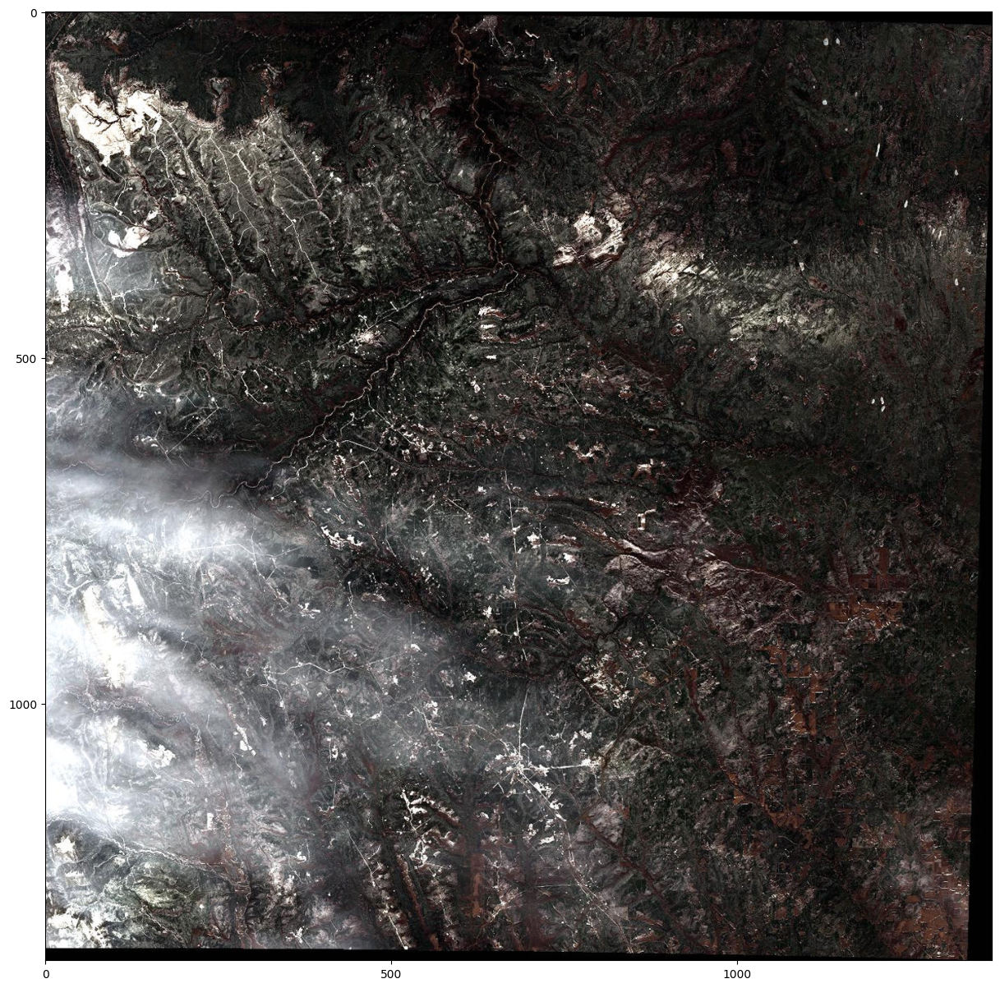

In [11]:
signature = "0440-6915"
# old_img_path ="/content/SegMate/Screenshot 2023-10-28 at 9.53.33 PM copy.jpg"
# old_img_path ="/content/SegMate/S2A_tile_20230624_10VFH_0_B04,B03,B02_M_[-120.86225773394109,55.88453651180963,-120.12255741655828,56.15654647586243].jpg"
old_img_path =  '/content/SegMate/S2A_tile_20230428_10VEJ_0_B04,B03,B02_M_[-123.00031914924803,56.74303998974159,-121.15655189224604,57.74228916996868].jpg'
old_image = load_image(old_img_path)
show_image(old_image, size=15, show_axis=True)

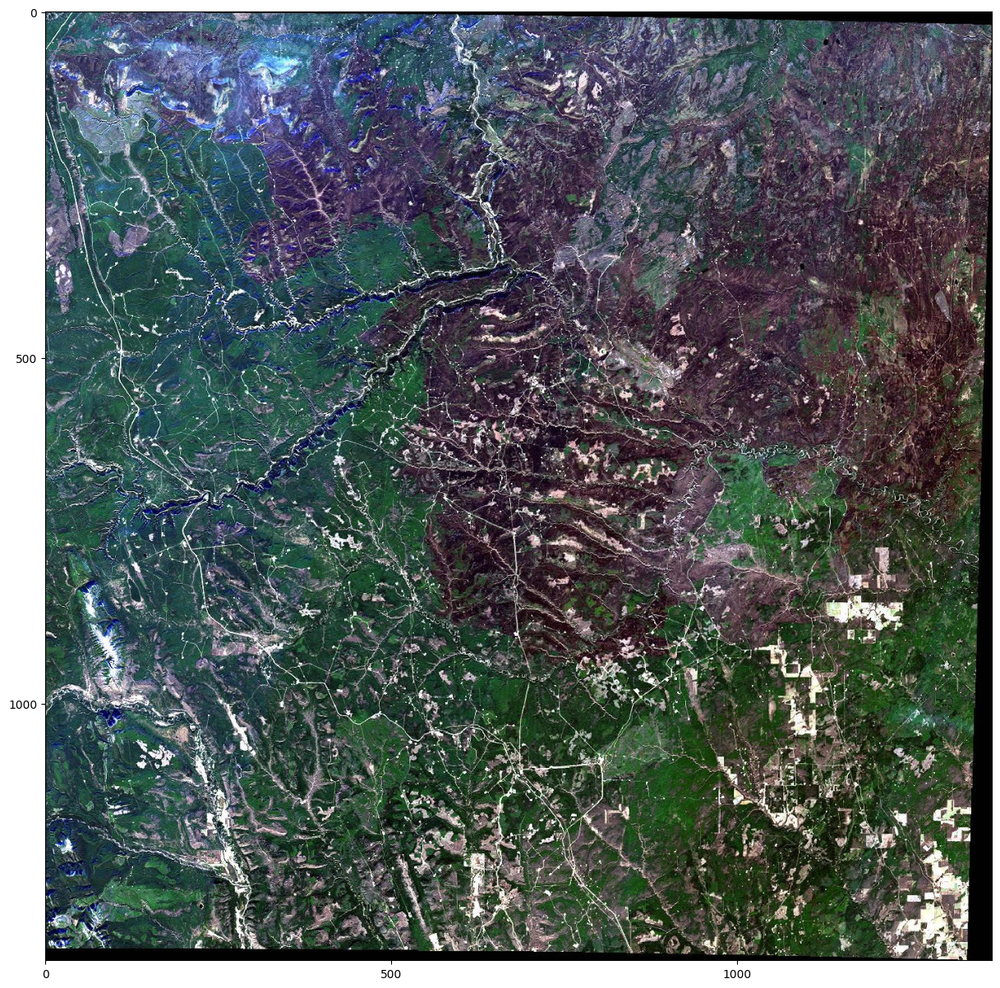

In [12]:
# new_img_path = '/content/SegMate/Screenshot 2023-10-28 at 9.53.26 PM copy.jpg'
# new_img_path = '/content/SegMate/S2B_tile_20231020_10VFH_0_B04,B03,B02_M_[-120.86225773394109,55.88453651180963,-120.12255741655828,56.15654647586243].jpg'
# new_img_path = '/content/SegMate/S2A_tile_20220920_10VEH_0_B04,B03,B02_M_[-123.00031146441698,55.844839734670174,-121.20091095825357,56.8438028335438].jpg'
new_img_path = "/content/SegMate/S2B_tile_20231020_10VEJ_0_PR_FD_M_[-123.00031914924803,56.74303998974159,-121.15655189224604,57.74228916996868].jpg"
new_image = load_image(new_img_path)
show_image(new_image, size=15, show_axis=True)

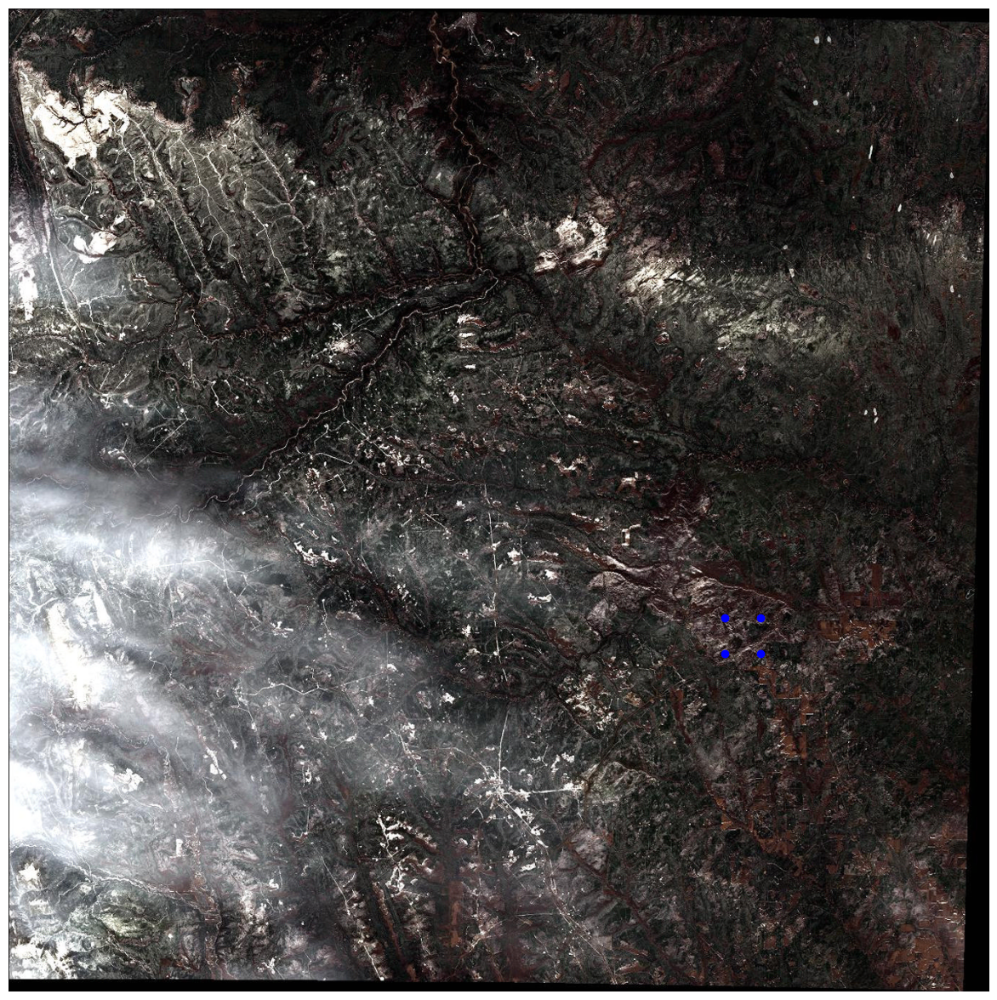

In [13]:
height, width, _ = old_image.shape
top_right_old = old_image[:, :, :]
# top_right_old = old_image[:height//2, width//2:, :]

# old_point_coords = [
#     [81, 90], [90, 90], [81, 65], [90, 65], [85, 80],
# ]

# old_point_labels = [
#     1, 1, 1, 1, 1
# ]

# old_point_coords = [
#     [281, 390], [490, 390], [481, 265], [290, 265]
# ]

# old_point_labels = [
#     1, 1, 1, 1
# ]

old_point_coords = [
    [1000, 900], [1000, 850], [1050, 850], [1050, 900]
]

old_point_labels = [
    1, 1, 1, 1
]


show_image(top_right_old, size=15, points=(old_point_coords, old_point_labels))

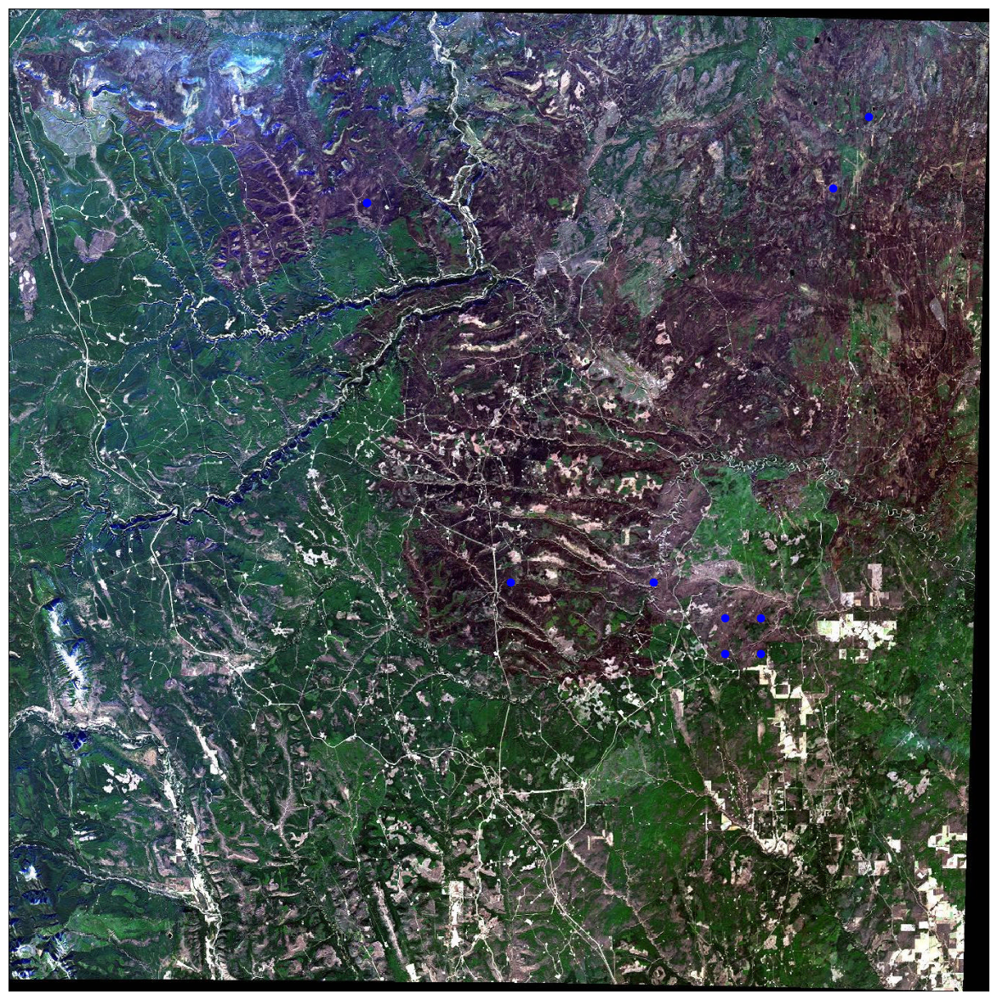

In [33]:
# top_right_new = new_image[:height//2, width//2:, :]
top_right_new = new_image[:, :, :]

# new_point_coords = [
#     [81, 95], [90, 95], [81, 70], [90, 70], [85, 85],[85, 65], [75, 55],
#     # [50, 134], [60, 134], [85, 115]
# ]

# new_point_labels = [
#     1, 1, 1, 1, 1,
#     1, 1
# ]

# new_point_coords = [
#     [281, 390], [490, 390], [481, 265], [290, 265], [130, 465]
# ]

# new_point_labels = [
#     1, 1, 1, 1, 1
# ]


new_point_coords = [
    [1000, 900], [1000, 850], [1050, 850], [1050, 900], [900, 800], [700,800], [500, 270],[500, 270], [1150, 250], [1200, 150]
]

new_point_labels = [
    1, 1, 1, 1, 1, 1, 1, 1, 1, 1
]

show_image(top_right_new, size=15, points=(new_point_coords, new_point_labels))

In [22]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [23]:
sam_path = '/content/drive/MyDrive/sam_vit_h_4b8939.pth'

In [24]:

sam = SAM(model_type='vit_h', checkpoint=sam_path)

In [25]:
top_right_old.shape

(1372, 1369, 3)

In [34]:
old_masks = sam.segment(top_right_old, points_prompt=(np.array(old_point_coords), np.array(old_point_labels)))


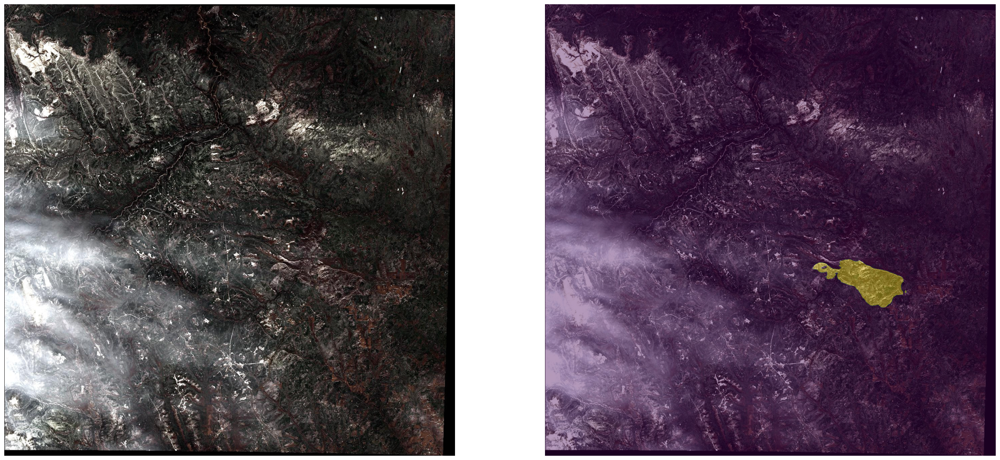

In [35]:
show_masks(top_right_old, old_masks, size=15)

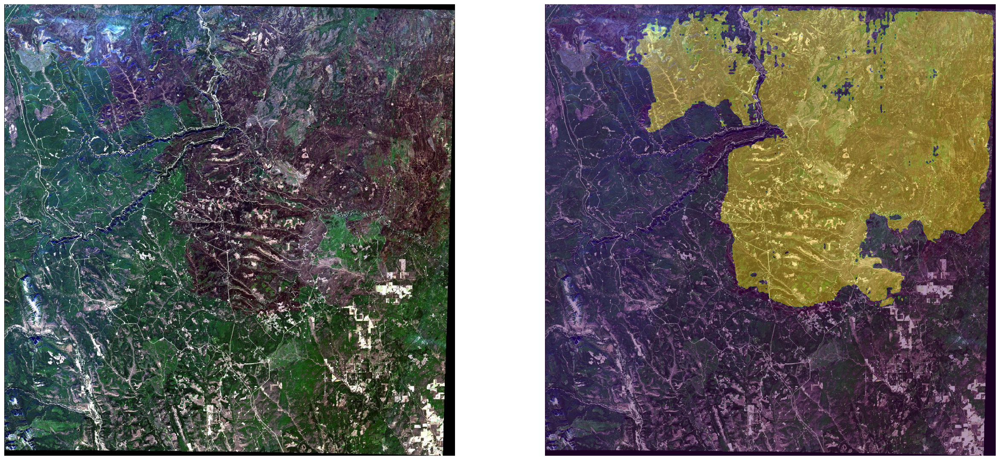

In [36]:
new_masks = sam.segment(top_right_new, points_prompt=(np.array(new_point_coords), np.array(new_point_labels)))
show_masks(top_right_new, new_masks, size=15)

In [37]:
old_mask_size = get_masks_size(old_masks)
old_mask_size

103.91488328609124

In [38]:
new_mask_size = get_masks_size(new_masks)
new_mask_size

3462.5942623736332

In [39]:
new_mask_size / old_mask_size

33.3214468695563

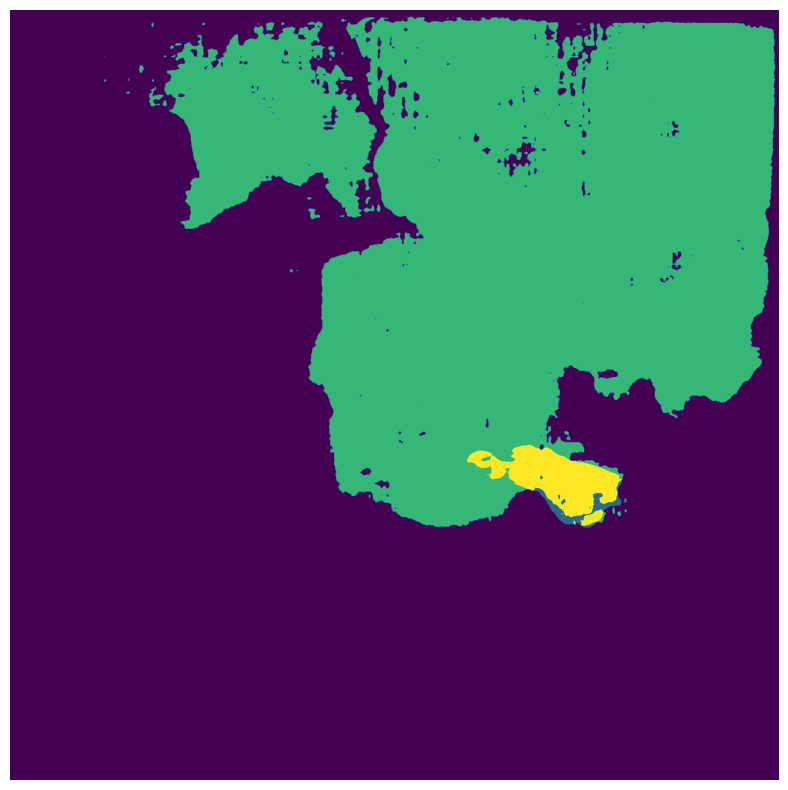

In [40]:
plot_mask_diff(old_masks, new_masks, size=10)